In [ ]:
mjolnir_path = "mjolnir"

#base_dir = "rtc_gridstd_p1e7_iso_thomas"
#base_dir = "../thor-data/alf_w_rt500_fixes/"
#base_dir = "waspalf/"
#base_dir = "waspalf_nothomas_short/"
#base_dir = "waspalf_nothomas_long/"

base_dir = "waspbb/"

In [2]:
# path to mjolnir code
import sys
sys.path.append(mjolnir_path) 

import pathlib
import re

import h5py
import imageio
import IPython.display as disp

import math

#%matplotlib ipympl
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageDraw, ImageFont, ImageOps

from scipy.optimize import root_scalar
# from pygifsicle import optimize

import hamarr as ham
import mjolnir_plot_helper as mph
from file_helpers import get_path_matching_regex, get_path_matching_regex_with_groups

In [3]:
from cycler import cycler


import pandas as pd

In [4]:
custom_cycler = (cycler(linestyle=['-', '--', '-.', ':']) * cycler(color=plt.rcParams['axes.prop_cycle'].by_key()['color'])      )


# plt.rc('lines', linewidth=4)

# set a custom cycler
plt.rc('axes', prop_cycle=custom_cycler)


In [5]:
alfdmp = pathlib.Path(f"{base_dir}/alfprof/")

In [6]:
FIGSIZE_x = 15
FIGSIZE_y = 11
dpi = 100


FIGSIZE = (FIGSIZE_x, FIGSIZE_y)

In [7]:
# use col_idx specified with mu_star plot, to help find correct column
# col_idx = 2384
step_idx = 1  
num_bins = 323
iso = True
has_hl = False

## read THOR Alf output file list

In [8]:
def col2dct(regmatch):
    out = {}
    for d in regmatch:
        out[int(d['groups'][0])] = d['path']
    return out



steps = col2dct(get_path_matching_regex_with_groups(alfdmp, "step_(\d+)"))

In [9]:
columns = col2dct(get_path_matching_regex_with_groups(steps[step_idx], "column_(\d+)"))

In [10]:
def load_columns_data(columns, dataset):
    out = {}
    for k, p in columns.items():
        out[k] = p / dataset
    return out

In [11]:
init_profs = load_columns_data(columns, "tpprofile_init.dat");
plk_profs = load_columns_data(columns, "plkprofile.dat");




In [12]:




interp_profs = load_columns_data(columns, "tprofile_interp.dat")
opac_profs = load_columns_data(columns, "opacprofile.dat")

deltacolmass_profs = load_columns_data(columns, "deltacolmassprofile.dat")
meanmolmass_profs = load_columns_data(columns, "meanmolmassprofile.dat")
opt_depth_profs = load_columns_data(columns, "opt_depthprofile.dat")

singscat_band_profs = load_columns_data(columns, "single_scat_band_profile.dat")

Fu_profs = load_columns_data(columns, "F_up_profile.dat")
Fd_profs = load_columns_data(columns, "F_down_profile.dat")
Fdir_profs = load_columns_data(columns, "F_dir_profile.dat")

In [13]:
trans_band_profs = load_columns_data(columns, "trans_band_profile.dat")

trans_band_upper_profs = load_columns_data(columns, "trans_band_upper_profile.dat")
trans_band_lower_profs = load_columns_data(columns, "trans_band_lower_profile.dat")

In [14]:
singscat_band_upper_profs = load_columns_data(columns, "single_scat_band_upper_profile.dat")
singscat_band_lower_profs = load_columns_data(columns, "single_scat_band_lower_profile.dat")

In [15]:

if iso:
    M_profs = load_columns_data(columns, "M_profile.dat")
    N_profs = load_columns_data(columns, "N_profile.dat")
    P_profs = load_columns_data(columns, "P_profile.dat")
    G_plus_profs = load_columns_data(columns, "G_plus_profile.dat")
    G_minus_profs = load_columns_data(columns, "G_minus_profile.dat")
    

    
if not iso:
    M_upper_profs = load_columns_data(columns, "M_upper_profile.dat")
    M_lower_profs = load_columns_data(columns, "M_lower_profile.dat")

    N_upper_profs = load_columns_data(columns, "N_upper_profile.dat")
    N_lower_profs = load_columns_data(columns, "N_lower_profile.dat")
    
    P_upper_profs = load_columns_data(columns, "P_upper_profile.dat")
    P_lower_profs = load_columns_data(columns, "P_lower_profile.dat")

    G_plus_upper_profs = load_columns_data(columns, "G_plus_upper_profile.dat")
    G_plus_lower_profs = load_columns_data(columns, "G_plus_lower_profile.dat")


    G_minus_upper_profs = load_columns_data(columns, "G_minus_upper_profile.dat")
    G_minus_lower_profs = load_columns_data(columns, "G_minus_lower_profile.dat")



In [16]:
interface_profs = load_columns_data(columns, "tpprofile_interface.dat")

In [17]:
alf_qheat_profs = load_columns_data(columns, "alf_qheat_profile.dat")
dgrt_qheat_profs = load_columns_data(columns, "dgrt_qheat_profile.dat")

# Col Lat Lon and column selection

By playing with col_idx and lookoing at TP profile, we can find the interesting column here

In [18]:

latlon = np.zeros((len(init_profs), 2))
mu_star_col = np.zeros((len(init_profs)))
ps_toa = np.zeros((len(init_profs)))
ps_boa = np.zeros((len(init_profs)))

for k, p in init_profs.items():
    f = p.open()
    line1 = f.readline()
    
    
    m = re.match("#.* lat: \[(.*)\] lon: \[(.*)\] mustar: \[(.*)\] P_BOA: \[(.*)\] P_TOA: \[(.*)\]", line1)
    if m is not None:
        # print(tp, ":", line1)
        # print("match: ", m.group(1), m.group(2), m.group(3))
        lat = float(m.group(1))
        lon = float(m.group(2))
        mustar = float(m.group(3))
        p_boa =  float(m.group(4))
        p_toa =  float(m.group(5))
    else:
        raise Exception("No match for config in TP file")
        
    if lat < 0.0:
        lat += 360.0
    latlon[k,:] = [lat, lon]
    mu_star_col[k] = mustar
    ps_toa[k] = p_toa
    ps_boa[k] = p_boa
    


In [19]:
#col_idx = 5*16*16
col_idx = 320
col_idx_offset_neg = 0
col_idx_offset_pos = 0
col_marker = list(range(col_idx - col_idx_offset_neg,col_idx+col_idx_offset_pos,1))

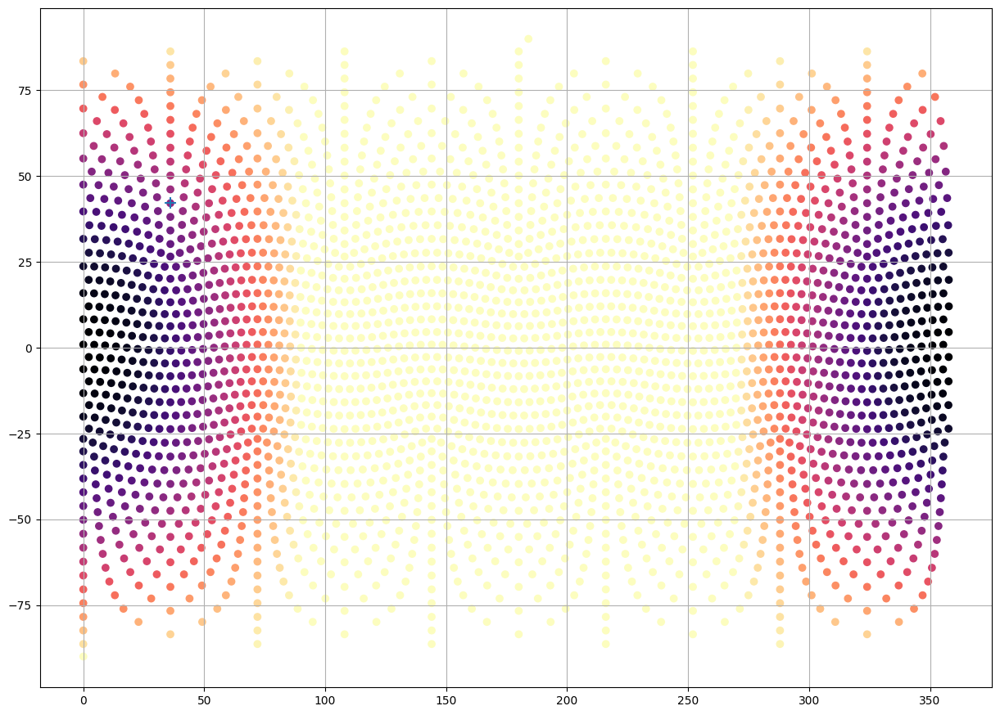

In [20]:

fig, ax = plt.subplots(1, 1, figsize=(1*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

ax.scatter(latlon[:,0], latlon[:,1], c=mu_star_col)

for col in col_marker:
    ax.scatter(latlon[col,0], latlon[col,1], marker='x', s=0.5, linewidth=10)
    
ax.scatter(latlon[col_idx,0], latlon[col_idx,1], marker='+', s=1.5, linewidth=10)

ax.grid(True)

mu_star = mu_star_col[col_idx]

In [21]:
n = 2540
delta = 1
stride = 1



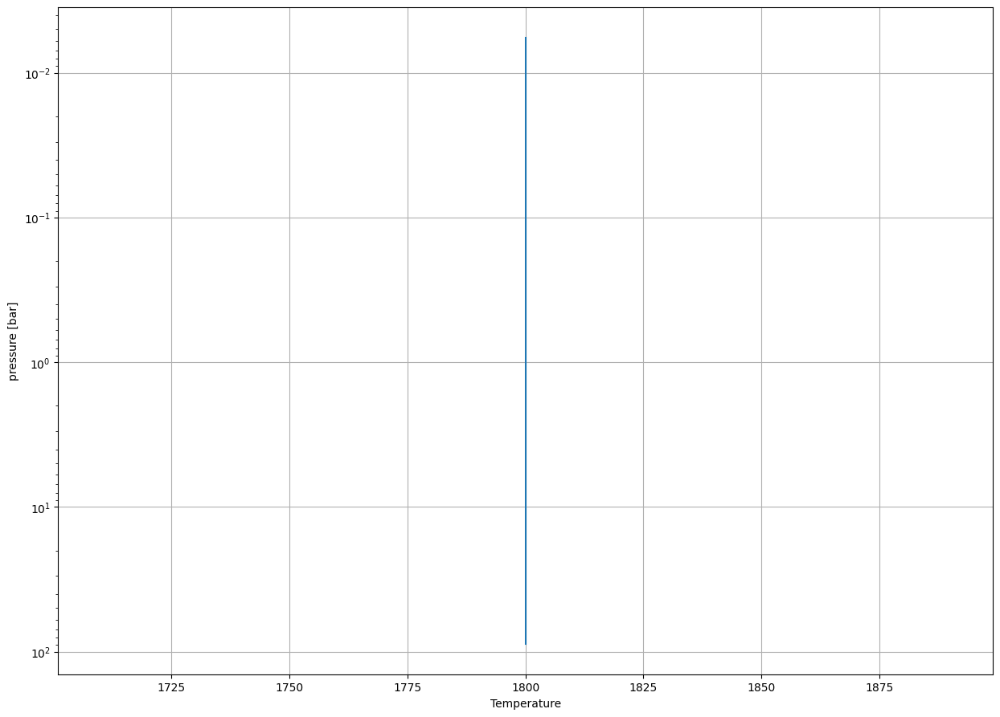

In [22]:
fig, ax = plt.subplots(1, 1, figsize=(1*FIGSIZE_x, FIGSIZE_y), dpi=dpi)
for i in range(n, n + delta, stride):
    init_table_col = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])
    
    
    
    ax.plot(  init_table_col['T'], init_table_col['P'], label=f'col[{i}]')


    
ax.set(xscale='linear', xlabel='Temperature')
ax.set(yscale='log', ylabel='pressure [bar]')
ax.invert_yaxis()
ax.grid(True)
#ax.legend()

# load helios data

In [23]:
hldmp =  pathlib.Path("../HELIOS-orig/alfdbg/")

hl_subdir = hldmp / f"alfprof_disc_{col_idx}" 
hl_planet = "alfprof_disc"

In [24]:
tpfile = hldmp / f"alfprof_{col_idx}" /  f"alfprof_{col_idx}_tp.dat" 

if has_hl:
    hl_tp =  pd.read_csv(tpfile, sep='\s+', header=0, skiprows=1) #, names = [
    # "layer",   "temp[K]",          "press.[10^-6bar]",        "altitude[cm]",         "height.of.layer[cm]",    "conv.unstable?[1:yes,0:no]",    "conv.lapse-rate?[1:yes,0:no]"
        #"layer",   "temp",          "press",        "altitude",         "height.of.layer",    "conv.unstable",    "conv.lapse-rate"
    #])

    hl_tp['press'] = hl_tp['press.[10^-6bar]']*1e-6
    hl_tp['temp'] = hl_tp['temp.[K]']

    # get rid of ghost layer
    hl_tp_lay = hl_tp.loc[1:, : ]
    hl_tp_lay

In [25]:

init_table = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])
interp_table = pd.read_csv(interp_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T'])
interface_table = pd.read_csv(interface_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])

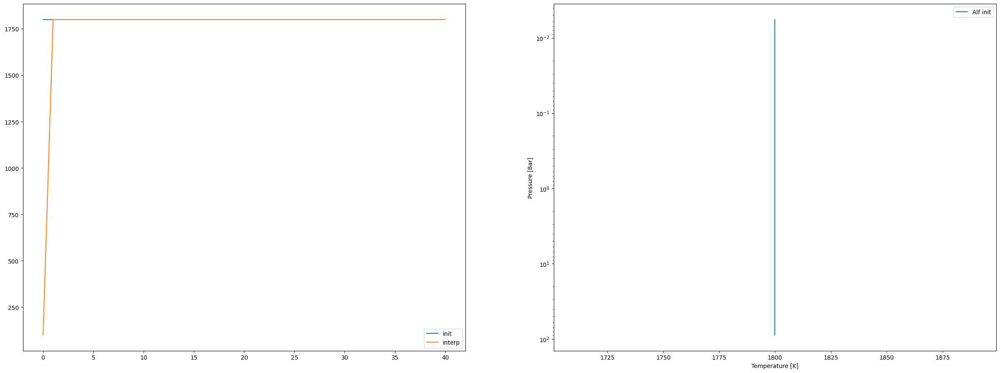

In [26]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)


if has_hl:
    ax1.plot(hl_tp_lay['temp'].values, label="hl")    
    ax2.plot(hl_tp_lay['temp'], hl_tp_lay['press'], label='hel')
    
ax1.plot(init_table['T'].values, label="init")
ax1.plot(interp_table['T'].values, label="interp")

ax1.legend()



ax2.plot(init_table['T'], init_table['P'], label='Alf init')

ax2.set(yscale='log', ylabel="Pressure [Bar]",
       xscale='linear', xlabel="Temperature [K]")
ax2.invert_yaxis()

ax2.legend()

#ax2.plot()


offset above between helios and thor is because of different height grids. gets corrected in pressure diplay

# TP Profile

In [27]:
col_idx

320

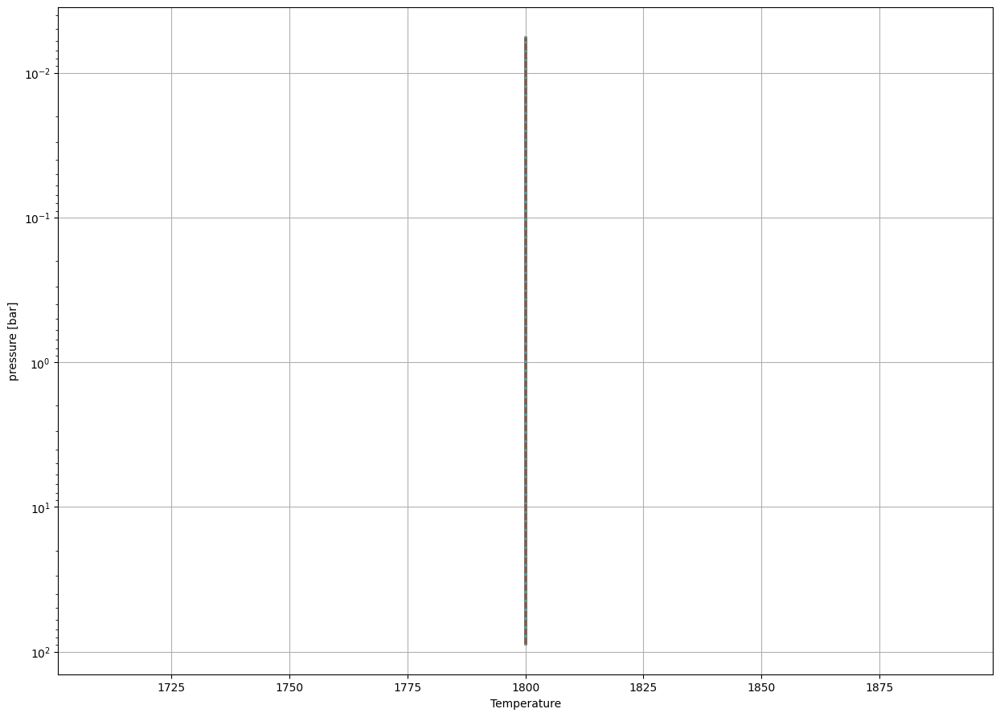

In [28]:
fig, ax = plt.subplots(1, 1, figsize=(1*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

n = 4*16*16
delta = 16*16
#delta = 0
stride = 1
rng = list(range(n, n + delta, stride)) #+ [col_idx]

vert_unit_pressure = True

for i in rng:
    init_table_col = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])
    
    if vert_unit_pressure:
        vert_unit = init_table_col['P']
    else:
        vert_unit = range(0, len(init_table_col['P']))
    
    ax.plot(  init_table_col['T'], vert_unit, label=f'col[{i}]')


    
ax.set(xscale='linear', xlabel='Temperature')

if vert_unit_pressure:
    ax.set(yscale='log', ylabel='pressure [bar]')
    ax.invert_yaxis()
else:
    ax.set(yscale='linear', ylabel='level')

ax.grid(True)
#ax.legend()

# plank function

In [29]:
if has_hl:
    hlpkfile = hl_subdir /  f"{hl_planet}_{col_idx}_planck_cent.dat" 

    hl_pk =  pd.read_csv(hlpkfile, sep='\s+', header=0, skiprows=2)

th_plk_table = pd.read_csv(plk_profs[col_idx], sep='\s+', header=0)

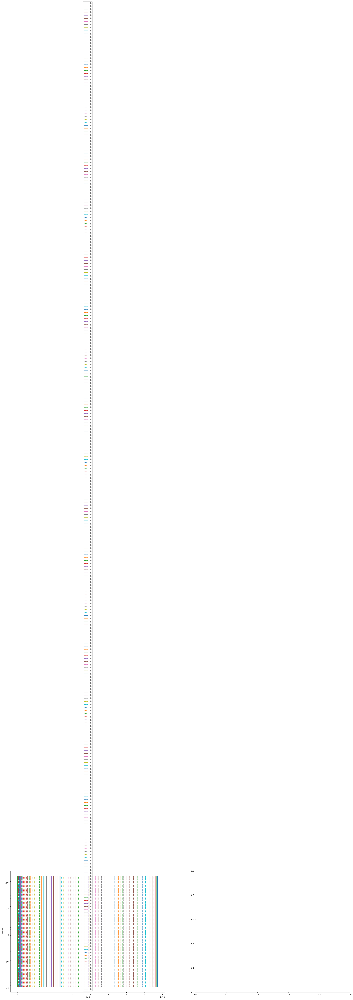

In [30]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)


th_pk_table = th_plk_table.loc[:,'layer[0]':'layer[39]'].values


for nbin in range(num_bins):
    init_table_col = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])
    ax1.plot(  th_pk_table[nbin,:], init_table_col['P'], label='th')

if has_hl:
    hl_pk_table = hl_pk.loc[:,'B_lay[0]':'B_lay[39]'].values
    ax1.plot( hl_pk_table[nbin,:]*1e-1,hl_tp_lay['press'], label='hl')

ax1.set(xscale='linear', xlabel='plank')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()

ax1.legend()

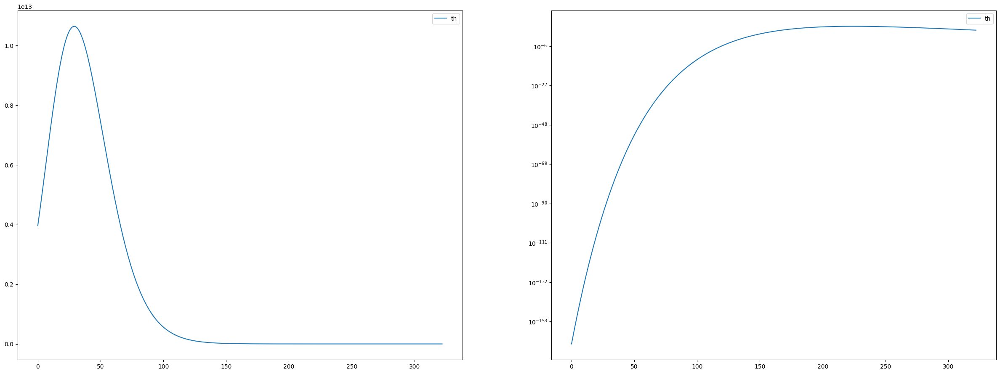

In [31]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

if has_hl:
    hl_toa = hl_pk['Planck_T_star']*1e-1
    ax1.plot(hl_toa, label='hl')
    hl_boa = hl_pk['Planck_T_intern']*1e-1
    ax2.plot(hl_boa, label='hl')    
    
th_toa = th_plk_table['layer[TOA]']

ax1.plot(th_toa, label='th')

ax1.legend()




th_boa = th_plk_table['layer[BOA]']


ax2.plot(th_boa, label='th')
ax2.set(yscale='log')
ax2.legend()



# opacities

In [32]:
th_opac_table = pd.read_csv(opac_profs[col_idx], sep='\s+', header=0)

In [33]:
if has_hl:
    hlopacfile =  hl_subdir /  f"{hl_planet}_{col_idx}_opacities.dat" 

    hl_opac =  pd.read_csv(hlopacfile, sep='\s+', header=0, skiprows=2)

In [34]:
th_opac_table;

No handles with labels found to put in legend.


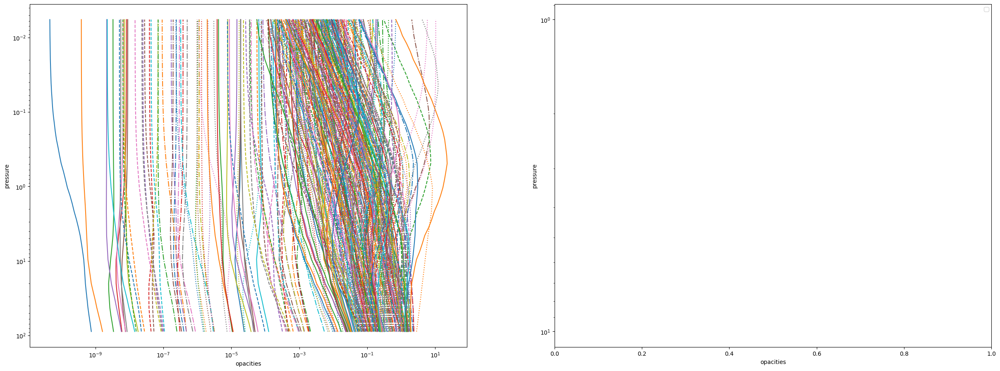

In [35]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

if has_hl:
    hl_oc_table = hl_opac.loc[:,'opac_lay[0]':'opac_lay[39]'].values
    for nbin in range(num_bins):
    #nbin = 34
    
        ax2.plot( hl_oc_table[nbin,:]*1e-1,hl_tp_lay['press'], label='hl')


th_opac_table = pd.read_csv(opac_profs[col_idx], sep='\s+', header=0)

col_TP_table = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])

th_oc_table = th_opac_table.loc[:,'layer[0]':'layer[39]'].values

for nbin in range(num_bins):
#nbin = 34

    ax1.plot(  th_oc_table[nbin,:], col_TP_table['P'], label=f'th[{nbin}]')
    

ax1.set(xscale='log', xlabel='opacities')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()

#ax1.legend()

ax2.set(xscale='linear', xlabel='opacities')
ax2.set(yscale='log', ylabel='pressure')
ax2.invert_yaxis()

ax2.legend()



# mean molecular weight

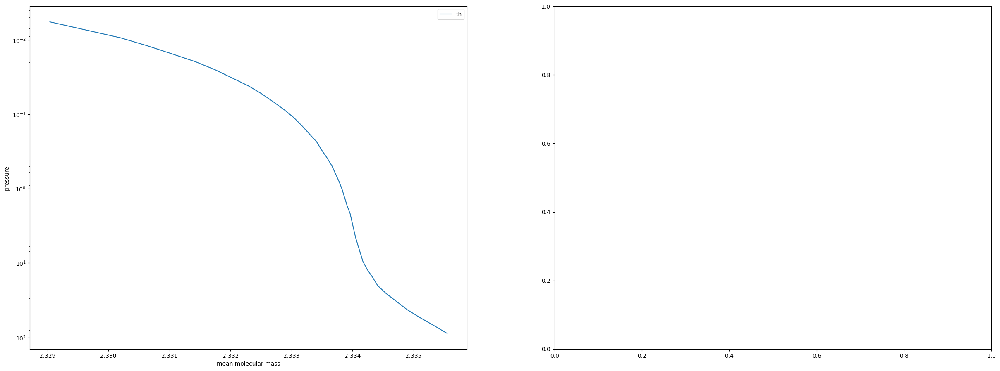

In [36]:

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

if has_hl:
    hlmmmfile = hl_subdir /  f"{hl_planet}_{col_idx}_colmass_mu_cp_kappa_entropy.dat" 

    hl_mmm =  pd.read_csv(hlmmmfile, sep='\s+', header=None, skiprows=2)

    hl_mmm_table = hl_mmm[3].values
    
    ax1.plot( hl_mmm_table,hl_tp_lay['press'], label='hl')

    
th_mmm_table = pd.read_csv(meanmolmass_profs[col_idx], sep='\s+', header=0)
th_mmm_table = th_mmm_table['meanmolmass'].values
col_TP_table = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])


ax1.plot(  th_mmm_table, col_TP_table['P'], label='th')


ax1.set(xscale='linear', xlabel='mean molecular mass')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()

ax1.legend()

# delta col mass

No handles with labels found to put in legend.


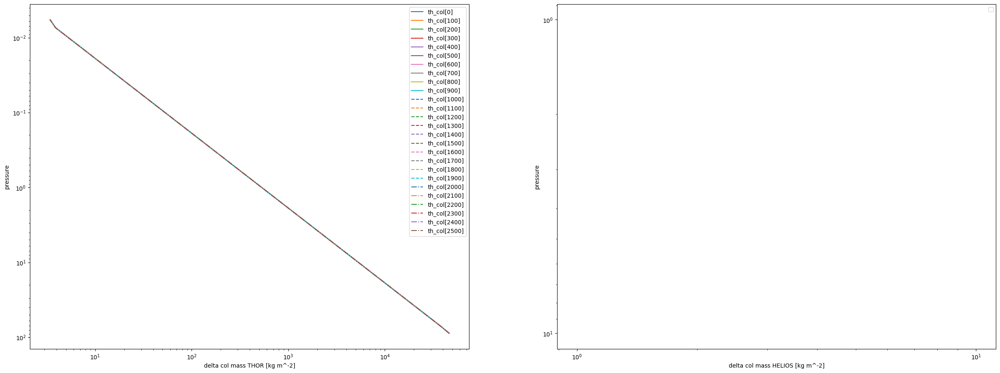

In [37]:

# reuse above file from MMM that contains also delta_col_mass



fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

for i in range(0,2562, 100):
    th_dcm_table = pd.read_csv(deltacolmass_profs[i], sep='\s+', header=0)
    th_dcm_table = th_dcm_table['delta_col_mass'].values

    col_TP_table = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])
    
    ax1.plot(  th_dcm_table, col_TP_table['P'], label=f'th_col[{i}]')
    
if has_hl:
    hl_dcm_table = hl_mmm[2].values*10
    for i in range(0,2562, 100):
        ax2.plot( hl_dcm_table,hl_tp_lay['press'], label='hl')

ax1.set(xscale='log', xlabel='delta col mass THOR [kg m^-2]')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()

ax1.legend()

ax2.set(xscale='log', xlabel='delta col mass HELIOS [kg m^-2]')
ax2.set(yscale='log', ylabel='pressure')
ax2.invert_yaxis()

ax2.legend()

# optical depth - delta tau 

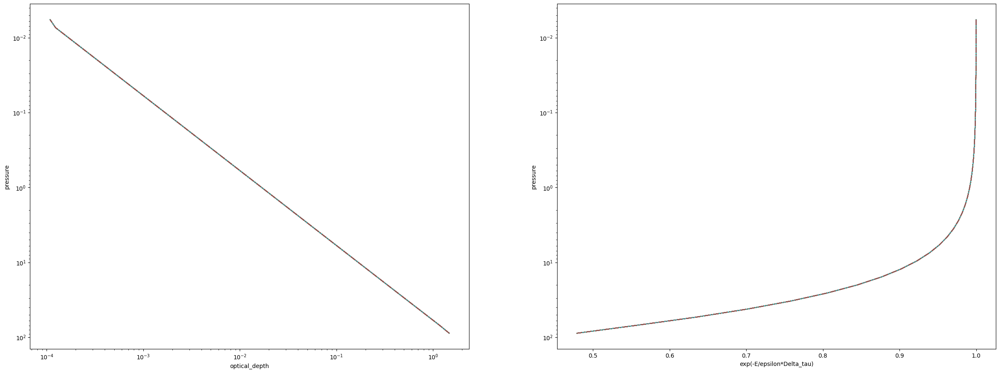

In [38]:



fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

nbin = 20
for i in range(0,2562, 100):
    th_optd_table = pd.read_csv(opt_depth_profs[i], sep='\s+', header=0)


    th_optd_table = th_optd_table.loc[:,'layer[0]':'layer[39]'].values
    
    col_TP_table = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])
    
    ax1.plot(  th_optd_table[nbin,:], col_TP_table['P'], label='th')
    ax2.plot(  np.exp(-0.5*th_optd_table[nbin,:]), init_table['P'], label='th')

ax1.set(xscale='log', xlabel='optical_depth')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()

#ax1.legend()

    
ax2.set(xscale='linear', xlabel='exp(-E/epsilon*Delta_tau)')
ax2.set(yscale='log', ylabel='pressure')
ax2.invert_yaxis()

#ax2.legend()

# transmission 

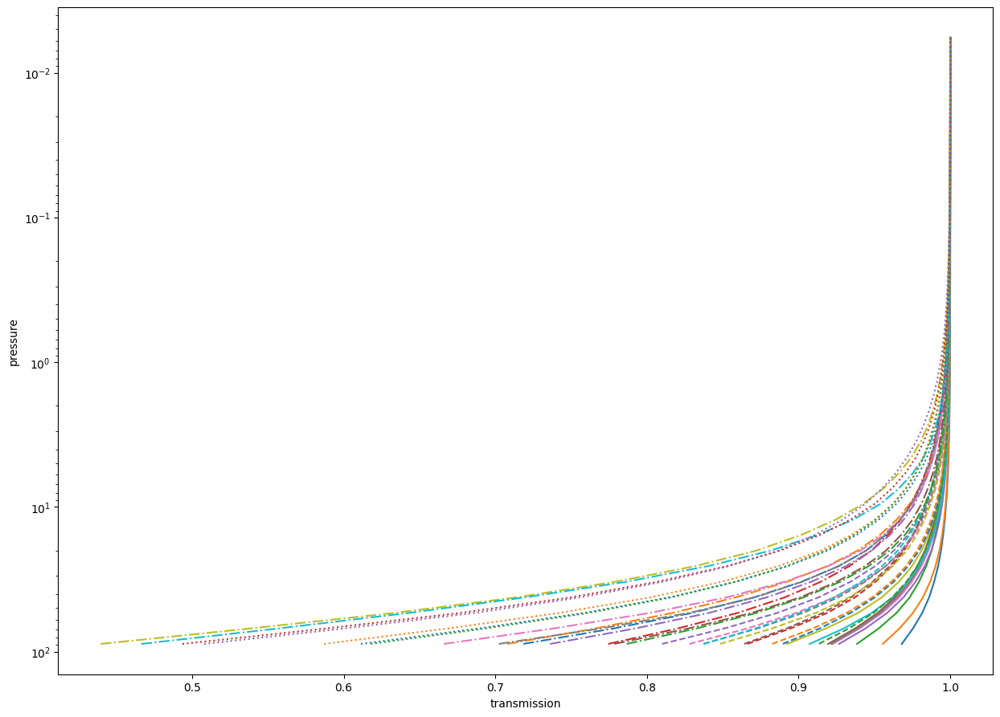

In [39]:
if iso:
    fig, ax = plt.subplots(1, 1, figsize=(1*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

    
    th_trans_table = pd.read_csv(trans_band_profs[col_idx], sep='\s+', header=0)

    th_trans_table = th_trans_table.loc[:,'layer[0]':'layer[39]'].values

    col_TP_table = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])
    
    
    for nbin in range(35):
        ax.plot(  th_trans_table[nbin,:], col_TP_table['P'], label=f'th_bin[{nbin}]')

    ax.set(xscale='linear', xlabel='transmission')
    ax.set(yscale='log', ylabel='pressure')
    ax.invert_yaxis()

    #ax.legend()

In [40]:
if not iso:
    fig, (ax_up, ax_lo) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

    th_trans_upper_table = pd.read_csv(trans_band_upper_profs[i], sep='\s+', header=0)
    th_trans_upper_table = th_trans_upper_table.loc[:,'layer[0]':'layer[39]'].values

    th_trans_lower_table = pd.read_csv(trans_band_lower_profs[i], sep='\s+', header=0)
    th_trans_lower_table = th_trans_lower_table.loc[:,'layer[0]':'layer[39]'].values

    
    for nbin in range(35):
        ax_lo.plot(  th_trans_lower_table[nbin,:], init_table['P'], label='th')
        ax_up.plot(  th_trans_upper_table[nbin,:], init_table['P'], label='th')

    ax_up.set(xscale='linear', xlabel='transmission')
    ax_up.set(yscale='log', ylabel='pressure')
    ax_up.invert_yaxis()

    #ax_up.legend()
    
    ax_lo.set(xscale='linear', xlabel='transmission')
    ax_lo.set(yscale='log', ylabel='pressure')
    ax_lo.invert_yaxis()

    #ax_lo.legend()

# single scat albedo

G_denom_roots: (0.30584250363562404, 0.30584250363562404)


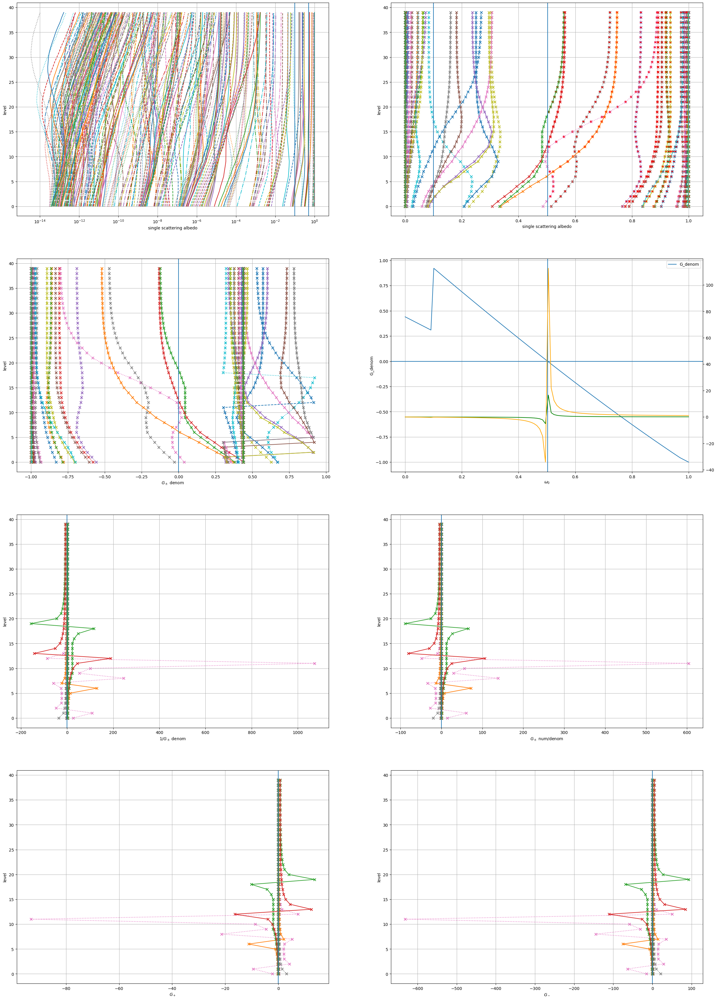

In [41]:
def E_i2s(w0, g0, i2s): 
    if g0 >= 0.0:
        r = np.ones(w0.shape)
        #print(w0[w0 > i2s])
        r[w0 > i2s] = np.maximum(1.0,  1.225 - 0.1582 * g0 - 0.1777 * w0[w0 > i2s] - 0.07465 * np.power(1.0 * g0, 2.0) + 0.2351 * w0[w0 > i2s] * g0
                    - 0.05582 * np.power(w0[w0 > i2s], 2.0))
        
        return r
    else:
        return 1.0

def E_noi2s(w0, g0, i2s): 
    
        return np.maximum(1.0,  1.225 - 0.1582 * g0 - 0.1777 * w0 - 0.07465 * np.power(1.0 * g0, 2.0) + 0.2351 * w0 * g0
                    - 0.05582 * np.power(w0, 2.0))

    
def E_cst(w0, g0, i2s): 
    
        return 1.0

        
def g_num(w0, g0, E, epsilon, epsilon2):
    return w0 * (E * (1.0 - w0 * g0) + g0 * epsilon / epsilon2)

def g_denom(w0, g0, E, mu, epsilon):
    return E*np.power(mu/epsilon, 2.0)*(E-w0)*(1-w0*g0) - 1.0

    # double num = w0 * (E * (1.0 - w0 * g0) + g0 * epsilon / epsilon2);

    # double denom = E * pow(mu_star / epsilon, 2.0) * (E - w0) * (1.0 - w0 * g0) - 1.0;
    
def g_second_plus(w0, g0, E, mu, epsilon):
    return mu / epsilon + 1.0 / (E * (1.0 - w0 * g0));

def g_second_minus(w0, g0, E, mu, epsilon):
    return mu / epsilon - 1.0 / (E * (1.0 - w0 * g0));


def g_third(w0, g0, E, epsilon, epsilon2):
    return epsilon * w0 * g0 / (epsilon2 * E * (1.0 - w0 * g0));

def G_plus(w0, g0, E, mu, epsilon, epsilon2):
    return 0.5*(g_num(w0, g0, E, epsilon, epsilon2) / g_denom(w0, g0, E, mu, epsilon) * g_second_plus(w0, g0, E, mu, epsilon) + g_third(w0, g0, E, epsilon, epsilon2))

def G_minus(w0, g0, E, mu, epsilon, epsilon2):
    return 0.5*(g_num(w0, g0, E, epsilon, epsilon2) / g_denom(w0, g0, E, mu, epsilon) * g_second_minus(w0, g0, E, mu, epsilon) - g_third(w0, g0, E, epsilon, epsilon2))

    
def G_denom_roots(g0, E, mu, epsilon):
    a = g0
    b  = 1.0+g0*E
    c = 1.0/(E*np.power(mu/epsilon, 2.0)) - E
    disc = np.sqrt(b*b-4.0*a*c)
    if g0 != 0.0:    
        return (-b + disc)/(2.0*a), (-b - disc)/(2.0*a)
    else:
        
        return (-c,-c)
    




g0 = 0.0
i2s = 0.1
epsilon = 0.5
epsilon_2 = 2.0/3.0
mu_star_l = mu_star*1.000

ver_coord_pressure = False

E_f = E_i2s

roots = G_denom_roots(g0, 1.0, mu_star_l, epsilon)

print(f"G_denom_roots: {roots}")

# root with the E function
root_result = root_scalar(lambda x: g_denom(np.array(x), g0, E_f(np.array(x), g0, i2s), mu_star_l, epsilon), bracket=(0.0,1.0), x0=roots[0], x1=roots[1]  )
root_E = root_result.root

if iso:
    


    fig, ((ax_omega, ax_omega_lin),(ax_fex, ax_g_denom), ( ax_1ofex, ax_numdenom ), (ax_g_plus, ax_g_minus)) = plt.subplots(4, 2, figsize=(2*FIGSIZE_x, 4*FIGSIZE_y), dpi=dpi)
    
    col_TP_table = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])
    if ver_coord_pressure:
        y_coord = col_TP_table['P']
    else:
        y_coord = np.arange(len(col_TP_table['P']))
    
    for nbin in range(num_bins):
        th_singscat_table = pd.read_csv(singscat_band_profs[col_idx], sep='\s+', header=0)
        th_w0_table = th_singscat_table.loc[:,'layer[0]':'layer[39]'].values
        w0_ = th_w0_table[nbin,:]
        th_num = g_num(w0_, g0, E_f(w0_, g0, i2s), epsilon, epsilon_2)
        th_fex = g_denom(w0_, g0, E_f(w0_, g0, i2s), mu_star_l, epsilon, )
        
        ax_omega.plot(  th_w0_table[nbin,:], y_coord, label=f'bin[{nbin}]')
        ax_omega_lin.plot(  th_w0_table[nbin,:], y_coord, label=f'bin[{nbin}]')
        ax_omega_lin.scatter(  th_w0_table[nbin,:], y_coord, label=f'bin[{nbin}]', marker='x')
        
        # mark the ones with negative denom
        ax_omega_lin.scatter(  th_w0_table[nbin,:][th_fex < 0.0] , y_coord[th_fex < 0.0], label=f'bin[{nbin}]', marker='+', color='r')
        
        ax_fex.scatter(th_fex,y_coord, label=f'bin[{nbin}]', marker='x')
        ax_fex.plot(th_fex, y_coord, label=f'bin[{nbin}]', marker='x')

        ax_1ofex.scatter(1.0/th_fex, y_coord, label=f'bin[{nbin}]', marker='x')
        ax_1ofex.plot(1.0/th_fex, y_coord, label=f'bin[{nbin}]', marker='x')
        
        ax_numdenom.scatter(th_num/th_fex, y_coord, label=f'bin[{nbin}]', marker='x')
        ax_numdenom.plot(th_num/th_fex, y_coord, label=f'bin[{nbin}]', marker='x')
        
        Gp =  G_plus(w0_, g0, E_f(w0_, g0, i2s), mu_star_l, epsilon, epsilon_2)
        ax_g_plus.scatter(Gp, y_coord, label=f'bin[{nbin}]', marker='x')
        ax_g_plus.plot(Gp, y_coord, label=f'bin[{nbin}]', marker='x')
        
        Gm =  G_minus(w0_, g0, E_f(w0_, g0, i2s), mu_star_l, epsilon, epsilon_2)
        ax_g_minus.scatter(Gm, y_coord, label=f'bin[{nbin}]', marker='x')
        ax_g_minus.plot(Gm, y_coord, label=f'bin[{nbin}]', marker='x')
        
        
    omega_int = np.linspace(0.0, 1.0, 100)
    ax_g_denom.plot(omega_int, g_denom(omega_int, g0, E_f(omega_int, g0, i2s), mu_star_l, epsilon, ), label="G_denom")
    ax_g_denom_G_pm = ax_g_denom.twinx()
    ax_g_denom_G_pm.plot(omega_int, G_plus(omega_int, g0, E_f(omega_int, g0, i2s), mu_star_l, epsilon, epsilon_2), c='g', label="G_plus")
    ax_g_denom_G_pm.plot(omega_int, G_minus(omega_int, g0, E_f(omega_int, g0, i2s), mu_star_l, epsilon, epsilon_2), c='orange', label="G_minus")
    ax_g_denom.grid(True)
    ax_g_denom.axhline(0.0)
    ax_g_denom.axvline(root_E)
    ax_g_denom.set(xlabel="$\omega_0$", ylabel="G_denom")
    ax_g_denom.legend()
        
    ax_omega.set(xscale='log', xlabel='single scattering albedo')
    if ver_coord_pressure:
        ax_omega.set(yscale='log', ylabel='pressure')
        ax_omega.invert_yaxis()
    else:
        ax_omega.set(yscale='linear', ylabel='level')
    ax_omega.axvline(i2s)
    ax_omega.axvline(root_E)
    ax_omega.grid(True)
    
    ax_omega_lin.set(xscale='linear', xlabel='single scattering albedo')
    if ver_coord_pressure:
        ax_omega_lin.set(yscale='log', ylabel='pressure')
        ax_omega_lin.invert_yaxis()
    else:
        ax_omega_lin.set(yscale='linear', ylabel='level')
    ax_omega_lin.axvline(i2s)
    ax_omega_lin.axvline(root_E)
    ax_omega_lin.grid(True)
    
    dx = 1.0e-2
    #ax_fex.set(xscale='linear', xlabel='$G_\pm$ denom', xlim=[-dx,dx])
    ax_fex.set(xscale='linear', xlabel='$G_\pm$ denom')
    if ver_coord_pressure:
        ax_fex.set(yscale='log', ylabel='pressure')
        ax_fex.invert_yaxis()
    else:
        ax_fex.set(yscale='linear', ylabel='level')
    ax_fex.axvline(0.0)
    ax_fex.grid(True)
    
    ax_1ofex.set(xscale='linear', xlabel=r'$1 / G_\pm$ denom')
    if ver_coord_pressure:
        ax_1ofex.set(yscale='log', ylabel='pressure')
        ax_1ofex.invert_yaxis()
    else:
        ax_1ofex.set(yscale='linear', ylabel='level')
    ax_1ofex.axvline(0.0)
    ax_1ofex.grid(True)
    #ax_1ofex.legend()
    
    ax_numdenom.set(xscale='linear', xlabel='$G_\pm$ num/denom')
    if ver_coord_pressure:
        ax_numdenom.set(yscale='log', ylabel='pressure')
        ax_numdenom.invert_yaxis()
    else:
        ax_numdenom.set(yscale='linear', ylabel='level')
    ax_numdenom.axvline(0.0)
    ax_numdenom.grid(True)
    
    
    ax_g_plus.set(xscale='linear', xlabel='$G_+$')
    if ver_coord_pressure:
        ax_g_plus.set(yscale='log', ylabel='pressure')
        ax_g_plus.invert_yaxis()
    else:
        ax_g_plus.set(yscale='linear', ylabel='level')
    ax_g_plus.axvline(0.0)
    ax_g_plus.grid(True)
    
    ax_g_minus.set(xscale='linear', xlabel='$G_-$')
    if ver_coord_pressure:
        ax_g_minus.set(yscale='log', ylabel='pressure')
        ax_g_minus.invert_yaxis()
    else:
        ax_g_minus.set(yscale='linear', ylabel='level')
    ax_g_minus.axvline(0.0)
    ax_g_minus.grid(True)

In [42]:
if not iso:



    fig, ((ax1, ax2), (ax3,ax4)) = plt.subplots(2, 2, figsize=(2*FIGSIZE_x, 2*FIGSIZE_y), dpi=dpi)

    
    go = 0.0
    ms = -0.7
    epsi = 0.5

    for nbin in range(num_bins):
        th_singscat_upper_table = pd.read_csv(singscat_band_upper_profs[i], sep='\s+', header=0)
        th_w0_upper_table = th_singscat_upper_table.loc[:,'layer[0]':'layer[39]'].values

        ax1.plot(  th_w0_upper_table[nbin,:], init_table['P'], label=f'th[i]')
    
        th_singscat_lower_table = pd.read_csv(singscat_band_lower_profs[i], sep='\s+', header=0)
        th_w0_lower_table = th_singscat_lower_table.loc[:,'layer[0]':'layer[39]'].values

        ax2.plot(  th_w0_lower_table[nbin,:], init_table['P'], label=f'th[{nbin}]')
        
    
        wo = th_w0_lower_table[nbin,:]
        
        
        #L = ((1-wo)*(1-wo*go) - 1)/(pow(ms, -2) + 1/epsi*(1-wo)*(1-wo*go) )
        #g_p = 0.5*(L*(1/epsi + 1.0/(ms*1-wo*go)) + wo*go*ms/(1 - wo*go) )
        g_p = 0.5*((-wo/(1-pow(ms/epsi,2)*(1-wo)))*(pow(ms,2)/epsi+ms))
        
        
        g_m = 0.5*((-wo/(1-pow(ms/epsi,2)*(1-wo)))*(pow(ms,2)/epsi-ms))
    
    
        ax3.plot(  g_p, init_table['P'], label=f'th[i]')
        ax4.plot(  g_m, init_table['P'], label=f'th[i]')
        
    
    ax1.set(xscale='log', xlabel='single scattering albedo')
    ax1.set(yscale='log', ylabel='pressure')
    ax1.invert_yaxis()
    ax1.set_title("upper")
    
    if go != 0:
        a = go
        d = 1
        c = pow(ms/epsi, 2)
    
        det = pow(-1 - a * d,2) - 4*a*(d-1/c)
        dp = (1 + a*d + math.sqrt(det))/(4*a*(d-1/c))
        dm = (1 + a*d - math.sqrt(det))/(4*a*(d-1/c))
        ax2.vlines(dp)
        ax2.vlines(dm)

    else:
        l = 1 - pow(epsi/ms, 2.0)
    
        ax2.axvline(l)
        print(f"lim w_0: {l}" )
    
    ax2.set(xscale='log', xlabel='single scattering albedo')
    #ax2.set(xlim=[1-0.1, 1], yscale='log', ylabel='pressure')
    ax2.set( yscale='log', ylabel='pressure')
    ax2.invert_yaxis()
    ax2.set_title("lower")

    
    ax3.set(xscale='linear', xlabel='single scattering albedo')
    ax3.set(yscale='log', ylabel='pressure')
    ax3.invert_yaxis()
    ax3.set_title("G_plus_lower")
    
    
    ax4.set(xscale='linear', xlabel='single scattering albedo')
    ax4.set(yscale='log', ylabel='pressure')
    ax4.invert_yaxis()
    ax4.set_title("G_minus_lower")
    
    ax4.legend()


# Flux

### global

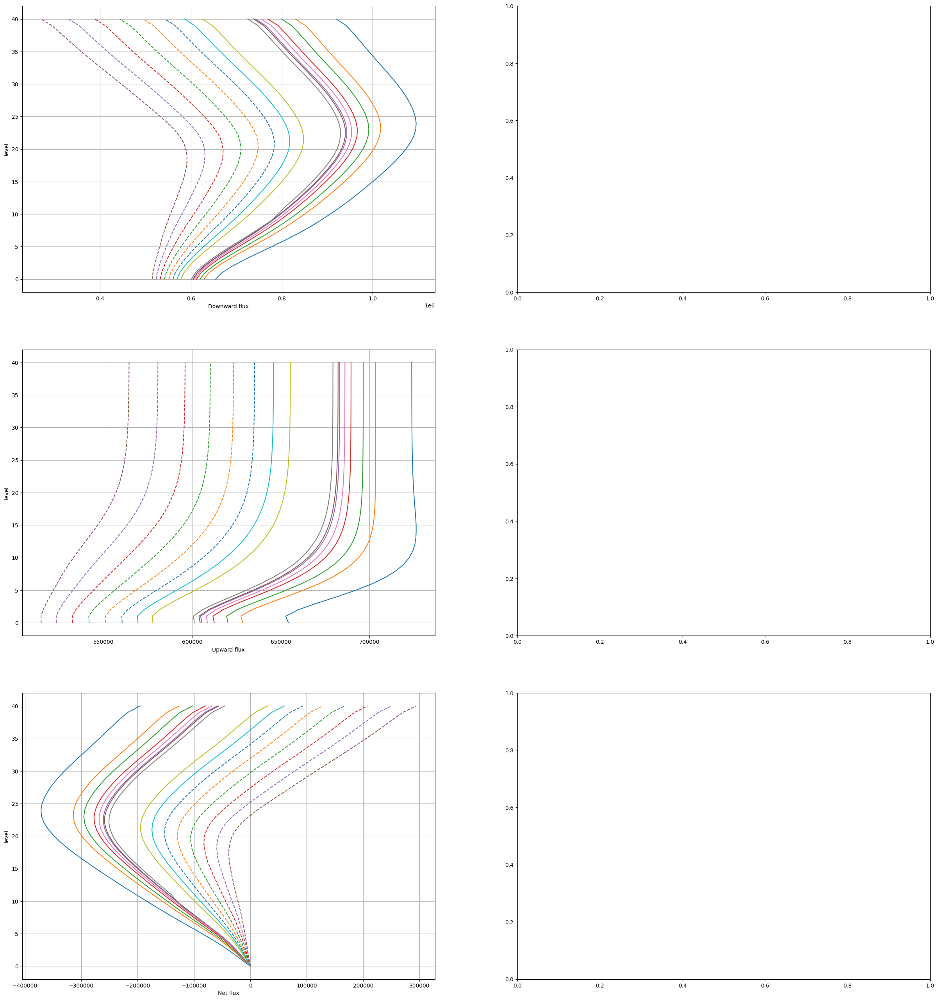

In [43]:
nbin = num_bins

ver_unit_pressure = False

fig, ((ax_down_th, ax_down_hl),
     (ax_up_th, ax_up_hl),
     (ax_tot_th, ax_tot_hl)) = plt.subplots(3, 2, figsize=(2*FIGSIZE_x, 3*FIGSIZE_y), dpi=dpi)

n = col_idx
delta = 16
stride = 1

rng = list(range(n, n + delta, stride)) #+ [col_idx]

for i in rng:
    
    fu_table = pd.read_csv(Fu_profs[i], sep='\s+', header=0)
    fu_tot = ((fu_table.loc[:,'interface[0]':'interface[40]']).multiply(fu_table['deltalambda'], axis='index')).sum().values
    
    fd_table = pd.read_csv(Fd_profs[i], sep='\s+', header=0)
    fd_val = fd_table.loc[:,'interface[0]':'interface[39]'].values
    
    fd_tot = ((fd_table.loc[:,'interface[0]':'interface[40]']).multiply(fd_table['deltalambda'], axis='index')).sum().values
    
    fdir_table = pd.read_csv(Fdir_profs[i], sep='\s+', header=0)
    fdir_tot = ((fdir_table.loc[:,'interface[0]':'interface[40]']).multiply(fdir_table['deltalambda'], axis='index')).sum().values
    f_tot = fdir_tot + fd_tot 
    
    interface_table_col = pd.read_csv(interface_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])['P']
    if ver_unit_pressure:
        ver_coord = interface_table_col
    else:
        ver_coord = np.arange(len(interface_table_col))
    
     
    
    
    ax_down_th.plot(  f_tot, ver_coord, label=f'col[{i}]')
    ax_up_th.plot(  fu_tot, ver_coord, label=f'col[{i}]')
    ax_tot_th.plot(  fu_tot - f_tot, ver_coord, label=f'col[{i}]')

        
    
if has_hl:    
    hlintflxfile = hldmp / f"alfprof_disc_{col_idx}" /  f"alfprof_disc_{col_idx}_integrated_flux.dat" 

    hl_intflx =  pd.read_csv(hlintflxfile, sep='\s+', header=0, skiprows=2)

    hl_fdir = hl_intflx['F_dir']
    hl_fdown = hl_intflx['F_down']
    hl_press = hl_intflx['press.[10^-6bar]']*1e-6
    ax_down_hl.plot((hl_fdir + hl_fdown)*1e-3, hl_press)
    
    
if ver_unit_pressure: 
    vscale = 'log'
    vlabel = 'pressure [bar]'
else:
    vscale = 'linear'
    vlabel = 'level'
    
ax_down_th.set(xscale='linear', xlabel='Downward flux')
ax_down_th.set(yscale=vscale, ylabel=vlabel)

if ver_unit_pressure:
    ax_down_th.invert_yaxis()
ax_down_th.grid(True)
#ax_down_th.legend()

ax_up_th.set(xscale='linear', xlabel='Upward flux')
ax_up_th.set(yscale=vscale, ylabel=vlabel)

if ver_unit_pressure:
    ax_up_th.invert_yaxis()
ax_up_th.grid(True)

ax_tot_th.set(xscale='linear', xlabel='Net flux')
ax_tot_th.set(yscale=vscale, ylabel=vlabel)

if ver_unit_pressure:
    ax_tot_th.invert_yaxis()
ax_tot_th.grid(True)
# ax.legend()

### column inspection

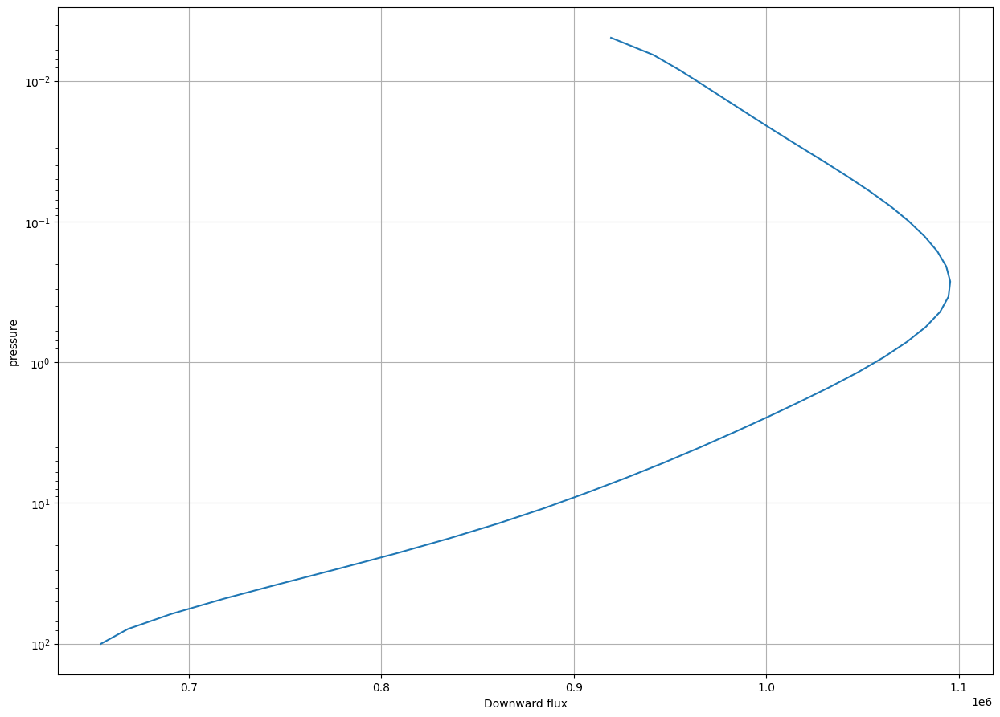

In [44]:
nbin = num_bins

fig, ax = plt.subplots(1, 1, figsize=(1*FIGSIZE_x, FIGSIZE_y), dpi=dpi)

n = col_idx
delta = 1
for i in range(n, n + delta, 1):
    fu_table = pd.read_csv(Fu_profs[i], sep='\s+', header=0)
    fu_tot = ((fu_table.loc[:,'interface[0]':'interface[40]']).multiply(fu_table['deltalambda'], axis='index')).sum().values
    
    fd_table = pd.read_csv(Fd_profs[i], sep='\s+', header=0)
    fd_val = fd_table.loc[:,'interface[0]':'interface[39]'].values
    
    fd_tot = ((fd_table.loc[:,'interface[0]':'interface[40]']).multiply(fd_table['deltalambda'], axis='index')).sum().values
    
    fdir_table = pd.read_csv(Fdir_profs[i], sep='\s+', header=0)
    fdir_tot = ((fdir_table.loc[:,'interface[0]':'interface[40]']).multiply(fdir_table['deltalambda'], axis='index')).sum().values
    f_tot = fdir_tot + fd_tot 
    
    ax.plot(  f_tot, interface_table['P'], label=f'col[{i}]')

if has_hl:
    hl_fdir = hl_intflx['F_dir']
    hl_fdown = hl_intflx['F_down']
    hl_press = hl_intflx['press.[10^-6bar]']*1e-6
    ax.plot((hl_fdir + hl_fdown)*1e-3, hl_press)
    
ax.set(xscale='linear', xlabel='Downward flux')
ax.set(yscale='log', ylabel='pressure')
ax.invert_yaxis()
ax.grid(True)
# ax.legend()

### wavelength bins

Text(0.5, 1.0, 'Up Diffuse Flux')

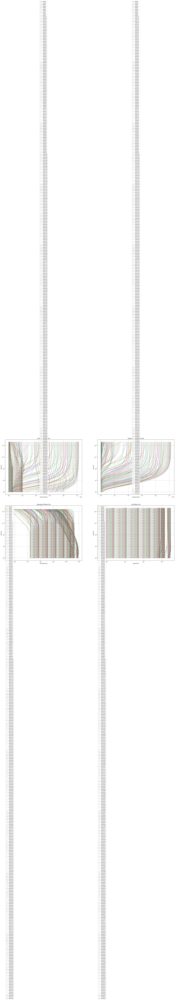

In [49]:
nbin = num_bins 


fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(2*FIGSIZE_x, 2*FIGSIZE_y), dpi=dpi)

i = col_idx

for n in range(0,num_bins):
    fu_table = pd.read_csv(Fu_profs[i], sep='\s+', header=0)
    fu_tot = fu_table.loc[n,'interface[0]':'interface[40]']
    
    fd_table = pd.read_csv(Fd_profs[i], sep='\s+', header=0)
    
    fd_tot = fd_table.loc[n,'interface[0]':'interface[40]']
    
    fdir_table = pd.read_csv(Fdir_profs[i], sep='\s+', header=0)
    fdir_tot = fdir_table.loc[n,'interface[0]':'interface[40]']
    f_tot = fdir_tot + fd_tot 
    
    
    ax1.plot(  f_tot, interface_table['P'], label=f'bin[{n}]')
    ax2.plot(  fdir_tot, interface_table['P'], label=f'bin[{n}]')
    ax3.plot(  fd_tot, interface_table['P'], label=f'bin[{n}]')
    ax4.plot(  fu_tot, interface_table['P'], label=f'bin[{n}]')


    
ax1.set(xscale='linear', xlabel='Downward flux')
ax1.set(yscale='log', ylabel='pressure')
ax1.invert_yaxis()
ax1.grid(True)
ax1.legend()
ax1.set_title("Downward Total Flux")

ax2.set(xscale='linear', xlabel='Downward flux')
ax2.set(yscale='log', ylabel='pressure')
ax2.invert_yaxis()
ax2.grid(True)
ax2.legend()
ax2.set_title("Downward Directional Flux")

ax3.set(xscale='log', xlabel='Downward flux')
ax3.set(yscale='log', ylabel='pressure')
ax3.invert_yaxis()
ax3.grid(True)
ax3.legend()
ax3.set_title("Downward Diffuse Flux")

ax4.set(xscale='log', xlabel='Upward flux')
ax4.set(yscale='log', ylabel='pressure')
ax4.invert_yaxis()
ax4.grid(True)
ax4.legend()
ax4.set_title("Up Diffuse Flux")

In [46]:
i = col_idx

fd_table = pd.read_csv(Fd_profs[i], sep='\s+', header=0)
fd_val = fd_table.loc[:,'interface[0]':'interface[39]'].values
    
f_tot = ((fd_table.loc[:,'interface[0]':'interface[40]']).multiply(fd_table['deltalambda'], axis='index')).sum().values


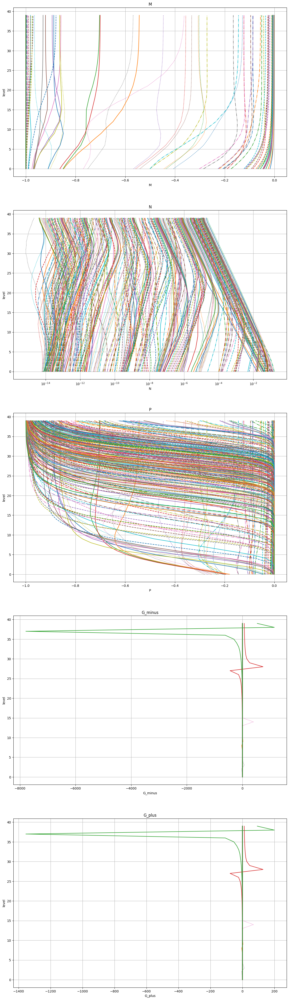

In [50]:
nbin = num_bins

i = col_idx

ver_coord_pressure = False


init_table_col = pd.read_csv(init_profs[col_idx], sep='\s+', header=None, skiprows=2, names=['T','P'])

def plot_stuff(stuff, ax, n):
    stuff_table = pd.read_csv(stuff, sep='\s+', header=0)
    stuff_tot = stuff_table.loc[n,'layer[0]':'layer[39]']
    if ver_coord_pressure:
        ax.plot(  stuff_tot, init_table_col['P'], label=f'bin[{n}]')
    else:
        ax.plot(  stuff_tot, np.arange(len(init_table_col['P'])), label=f'bin[{n}]')

def set_scale(ax, title, xlabel, xlog=False, ylog=True, xlim=None):
    if xlog:
        xscale = 'log'
    else:
        xscale = 'linear'
    if ylog:
        yscale = 'log'
    else:
        yscale = 'linear'
    if xlim is not None:
        ax.set_xlim(xlim)
    
    ax.set(xscale=xscale, xlabel=xlabel)
    if ver_coord_pressure:
        ax.set(yscale=yscale, ylabel='pressure')
        ax.invert_yaxis()
    else:
        ax.set(yscale='linear', ylabel='level')
    ax.grid(True)
    #ax.legend()
    ax.set_title(title)
    
if iso:
    fig, (ax_m, ax_n, ax_p, ax_g_minus, ax_g_plus)  = plt.subplots(5, 1, figsize=(1*FIGSIZE_x, 5*FIGSIZE_y), dpi=dpi)

    
    for n in range(0,num_bins):
        plot_stuff(M_profs[i], ax_m, n)
        plot_stuff(N_profs[i], ax_n, n)
        plot_stuff(P_profs[i], ax_p, n)
        plot_stuff(G_plus_profs[i], ax_g_plus, n)
        plot_stuff(G_minus_profs[i], ax_g_minus, n)
    
    set_scale(ax_m, "M", "M")
    set_scale(ax_n, "N", "N", xlog=True)
    set_scale(ax_p, "P", "P")
    #set_scale(ax_g_plus, "G_plus", "G_plus", xlog=False, xlim=[-1.2,1.2])
    #set_scale(ax_g_minus, "G_minus", "G_minus", xlog=False, xlim=[-1.2,1.2])
    
    set_scale(ax_g_plus, "G_plus", "G_plus", xlog=False)
    set_scale(ax_g_minus, "G_minus", "G_minus", xlog=False)

if not iso:
    fig, ((ax_m_upper, ax_m_lower),
      (ax_n_upper, ax_n_lower),
      (ax_p_upper, ax_p_lower),
      (ax_g_plus_upper, ax_g_minus_upper),
      (ax_g_plus_lower, ax_g_minus_lower))  = plt.subplots(5, 2, figsize=(2*FIGSIZE_x, 5*FIGSIZE_y), dpi=dpi)

    
    for n in range(0,num_bins):
        plot_stuff(M_upper_profs[i], ax_m_upper, n)
        plot_stuff(N_upper_profs[i], ax_n_upper, n)
        plot_stuff(P_upper_profs[i], ax_p_upper, n)
        plot_stuff(G_plus_upper_profs[i], ax_g_plus_upper, n)
        plot_stuff(G_minus_upper_profs[i], ax_g_minus_upper, n)
    
        plot_stuff(M_lower_profs[i], ax_m_lower, n)
        plot_stuff(N_lower_profs[i], ax_n_lower, n)
        plot_stuff(P_lower_profs[i], ax_p_lower, n)
        plot_stuff(G_plus_lower_profs[i], ax_g_plus_lower, n)
        plot_stuff(G_minus_lower_profs[i], ax_g_minus_lower, n)
    
    set_scale(ax_m_upper, "M_upper", "M_upper")
    set_scale(ax_m_lower, "M_lower", "M_lower")

    set_scale(ax_n_upper, "N_upper", "N_upper", xlog=True)
    set_scale(ax_n_lower, "N_lower", "N_lower", xlog=True)


    set_scale(ax_p_upper, "P_upper", "P_upper")
    set_scale(ax_p_lower, "P_lower", "P_lower")

    set_scale(ax_g_plus_upper, "G_plus_upper", "G_plus_upper", xlog=False, xlim=[-1.2,1.2])
    set_scale(ax_g_plus_lower, "G_plus_lower", "G_plus_lower", xlog=False, xlim=[-1.2,1.2])

    set_scale(ax_g_minus_upper, "G_minus_upper", "G_minus_upper", xlog=False, xlim=[-1.2,1.2])
    set_scale(ax_g_minus_lower, "G_minus_lower", "G_minus_lower", xlog=False, xlim=[-1.2,1.2])




# Qheat

In [48]:
nbin = num_bins

ver_unit_pressure = True

fig, (ax_alf, ax_dgrt) = plt.subplots(1, 2, figsize=(2*FIGSIZE_x, 1*FIGSIZE_y), dpi=dpi)

n = col_idx

n = 0
delta = 10*16*16+2
stride = 1

rng = list(range(n, n + delta, stride)) # + [col_idx]

for i in rng:
    
    alf_qh_table = pd.read_csv(alf_qheat_profs[i], sep='\s+', header=0)
    alf_qh = alf_qh_table['qheat'].values
    
    
    init_table_col = pd.read_csv(init_profs[i], sep='\s+', header=None, skiprows=2, names=['T','P'])['P']
    if ver_unit_pressure:
        ver_coord = init_table_col
    else:
        ver_coord = np.arange(len(init_table_col))
    
     
    
    
    ax_alf.plot(  alf_qh, ver_coord, label=f'col[{i}]')
    
    #dgrt_qh_table = pd.read_csv(dgrt_qheat_profs[i], sep='\s+', header=0)
    #dgrt_qh = dgrt_qh_table['qheat'].values
    
    

    
     
    
    
    #ax_dgrt.plot(  dgrt_qh, ver_coord, label=f'col[{i}]')


        
    
if ver_unit_pressure: 
    vscale = 'log'
    vlabel = 'pressure [bar]'
else:
    vscale = 'linear'
    vlabel = 'level'
    
ax_alf.set(xscale='linear', xlabel='QHeat, Alf')
ax_alf.set(yscale=vscale, ylabel=vlabel)

if ver_unit_pressure:
    ax_alf.invert_yaxis()
ax_alf.grid(True)

ax_alf.legend()


#ax_dgrt.set(xscale='linear', xlabel='QHEAT, DGRT')
#ax_dgrt.set(yscale=vscale, ylabel=vlabel)
#
#if ver_unit_pressure:
#    ax_dgrt.invert_yaxis()
#ax_dgrt.grid(True)
#
#ax_dgrt.legend()